In [5]:
%matplotlib inline

import glob
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation

import pyart
from tint import Cell_tracks, animate

In [6]:
path = '/home/camila/git/amazon-storms-aerosols/'
filenames = sorted([files for files in glob.glob(path + 'data/radar/sipam_manaus/arm/' + '**/*.HDF5', recursive=True)])
len(filenames)

3066

In [7]:
radar = pyart.aux_io.read_gamic(filenames[1000])

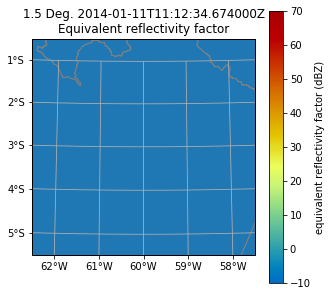

In [10]:
fig = plt.figure(figsize=(5, 5))
display = pyart.graph.RadarMapDisplay(radar)
display.plot_ppi_map('reflectivity', sweep=1, vmin=-10, vmax=70, ax=ax,
                     lon_0=-59.991, lat_0=-3.149, lon_lines=np.arange(-70, -50, 1), lat_lines=np.arange(-10, 0, 1),
                     min_lon=-62.5, max_lon=-57.5, min_lat=-5.5, max_lat=-0.5,
                     shapefile=path + 'data/general/shapefiles/estadosl_2007',
                     shapefile_kwargs={'edgecolor': 'gray', 'linewidth': 1})
fig.patch.set_alpha(0)

In [ ]:
def basic_plot(file):
    """ """
    plt.clf()
    radar = pyart.aux_io.read_gamic(file)
    display = pyart.graph.RadarMapDisplay(radar)
    display.plot_ppi_map('corrected_reflectivity', sweep=1, vmin=-10, vmax=70,
                         lon_0=-59.991, lat_0=-3.149, lon_lines=np.arange(-70, -50, 1), lat_lines=np.arange(-10, 0, 1),
                         min_lon=-62.5, max_lon=-57.5, min_lat=-5.5, max_lat=-0.5,
                         shapefile=path + 'data/general/shapefiles/estadosl_2007',
                         shapefile_kwargs={'crs': ccrs.PlateCarree(), 'edgecolor': 'gray',
                                           'color': '', 'linewidth': 0.75})
    del display, radar

In [ ]:
ppi_anim = FuncAnimation(plt.figure(figsize=(5, 5)), basic_plot, frames=filenames, interval=1000)